In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


In [ ]:
# Ross says:
# Let's download one of the models that we trained in Cellpose in Summer 2023.
# One of the overall OSF page for our project is https://osf.io/tuhwn/
# This specific URL will download the file that is designated https://osf.io/wkfgj
myurl="https://osf.io/download/wkfgj/"
mypath="Cellpose Autophagy Body model t_2_201"
! wget -O "Cellpose Autophagy Body model t_2_201" "https://osf.io/download/wkfgj/"

--2025-02-16 20:45:33--  https://osf.io/download/wkfgj/
Resolving osf.io (osf.io)... 35.190.84.173
Connecting to osf.io (osf.io)|35.190.84.173|:443... connected.
HTTP request sent, awaiting response... 302 FOUND
Location: https://files.osf.io/v1/resources/wrez4/providers/osfstorage/652575cd990755016ea1d6c7 [following]
--2025-02-16 20:45:34--  https://files.osf.io/v1/resources/wrez4/providers/osfstorage/652575cd990755016ea1d6c7
Resolving files.osf.io (files.osf.io)... 35.186.214.196
Connecting to files.osf.io (files.osf.io)|35.186.214.196|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://storage.googleapis.com/cos-osf-prod-files-us-east1/7b7a80f5d3579e770798deebbc0f3efcf415ad4d38ea132bad6a491693a15fb3?response-content-disposition=attachment%3B%20filename%3D%22Cellpose%20Autophagy%20Body%20model%20t_2_201%22%3B%20filename%2A%3DUTF-8%27%27Cellpose%2520Autophagy%2520Body%2520model%2520t_2_201&GoogleAccessId=files-us%40cos-osf-prod.iam.gserviceaccount.co

In [ ]:
!ls -al



total 182776
drwxr-xr-x 1 root root     4096 Feb 16 20:42  .
drwxr-xr-x 1 root root     4096 Feb 16 20:38  ..
-rw-r--r-- 1 root root    20313 Dec 24 19:41  1B6-058OutlinedJB_cp_masks.png
-rw-r--r-- 1 root root 62436407 Dec 24 19:26  1B6-058OutlinedJB_seg.npy
-rw-r--r-- 1 root root 15053058 Dec 24 19:37  1B6-058OutlinedJB.tif
-rw-r--r-- 1 root root    29560 Dec 24 19:49  1B6-059OutlinedJB_cp_masks.png
-rw-r--r-- 1 root root 67937550 Dec 24 18:22  1B6-059OutlinedJB_seg.npy
-rw-r--r-- 1 root root 15053058 Dec 24 19:10  1B6-059OutlinedJB.tif
-rw-r--r-- 1 root root 26597007 Dec 24 19:15 'Cellpose Autophagy Body model t_2_201'
drwxr-xr-x 4 root root     4096 Feb 13 14:18  .config
drwxr-xr-x 1 root root     4096 Feb 13 14:19  sample_data


In [ ]:
# How to deal with a custom cellpose model?
#  https://cellpose.readthedocs.io/en/latest/models.html#user-trained-models
# says to try:
# models.CellposeModel(pretrained_model='/full/path/to/model')

In [ ]:
# We can explore what's in the model file ourselves by unzipping it and looking at the files:
# !unzip 'Cellpose Autophagy Body model t_2_201'

says things like:

extracting: cellpose_residual_on_style_on_concatenation_off_t_2_2023_08_08_20_57_59/data/21  
extracting: cellpose_residual_on_style_on_concatenation_off_t_2_2023_08_08_20_57_59/data/210  

Each of those seems to be all binary with no internal structure. Perhaps instead of trying to read each one ourselves, we should just tell cellpose to load it up (however it does that) and then we can inspect the results in Python.

In [ ]:
# This code doesn't work:
# First try, not necessarily the right thing to do!
# import pickle
# file = open(mypath, 'rb')

# file = open('cellpose_residual_on_style_on_concatenation_off_t_2_2023_08_08_20_57_59/data.pkl', 'rb')

# data = pickle.load(file)

# # close the file
# file.close()


## load some image files from OSF

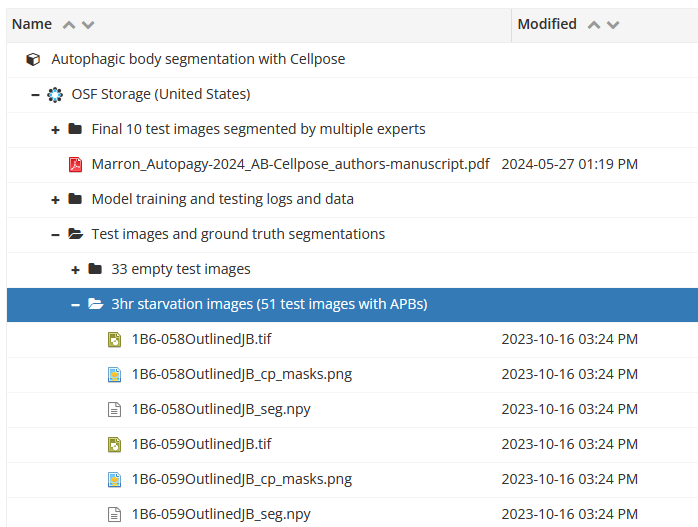

In [ ]:
# overall OSF project page: https://osf.io/tuhwn/

# An individual image file from training data:
# https://osf.io/cpkd2 which is  1B6-002OutlinedJB.tif and we can use this URL to download it directly: https://osf.io/download/cpkd2
# https://osf.io/rab5y which is  1B6-002OutlinedJB_seg.npy

#! wget -O "1B6-002OutlinedJB.tif" "https://osf.io/download/cpkd2"
#

# from:
# Test images and ground truth segmentations
# 3hr starvation images (51 test images with APBs)

# A nice way to embed data in a notebook, from:
# https://www.statsmodels.org/stable/examples/notebooks/generated/chi2_fitting.html

data_for_df = """
filename URL
1B6-058OutlinedJB.tif https://osf.io/jh6ep
1B6-058OutlinedJB_cp_masks.png https://osf.io/6bgnv
1B6-058OutlinedJB_seg.npy https://osf.io/5mtdz
1B6-059OutlinedJB.tif https://osf.io/hm9za
1B6-059OutlinedJB_cp_masks.png https://osf.io/y29rz
1B6-059OutlinedJB_seg.npy https://osf.io/dvphk
"""
# Sometimes when we copy/paste from a webpage or from an email,
# some of the spaces are actually "non-breaking spaces", and that
# can mess up conversion to a data frame. So, we'll replace
# non-breaking spaces (which have hex code a0 or ASCII decimal 160)
# with simple spaces.
data_for_df = data_for_df.replace('\xa0', ' ')

import pandas as pd
try:
  from StringIO import StringIO
except ImportError:
  from io import StringIO
df_files = pd.read_csv(StringIO(data_for_df), sep='\s+')

# make a download URL by inserting the word "download/" after osf.io/:
df_files['URL_download'] = df_files['URL'].str.replace('osf.io/', 'osf.io/download/')
df_files.head(10)

,filename,URL,URL_download
0,1B6-058OutlinedJB.tif,https://osf.io/jh6ep,https://osf.io/download/jh6ep
1,1B6-058OutlinedJB_cp_masks.png,https://osf.io/6bgnv,https://osf.io/download/6bgnv
2,1B6-058OutlinedJB_seg.npy,https://osf.io/5mtdz,https://osf.io/download/5mtdz
3,1B6-059OutlinedJB.tif,https://osf.io/hm9za,https://osf.io/download/hm9za
4,1B6-059OutlinedJB_cp_masks.png,https://osf.io/y29rz,https://osf.io/download/y29rz
5,1B6-059OutlinedJB_seg.npy,https://osf.io/dvphk,https://osf.io/download/dvphk


In [ ]:
# write a for-loop to download each file in the df_files dataframe:
#for i in range(len(df_files)): # -nv means non-verbose (slightly quiet, but not fully quiet)
#    ! wget -nv -O df['filename'] df['URL_download']

for index, row in df_files.iterrows():
    !wget -nv -O {row['filename']} {row['URL_download']}

2025-02-16 20:45:35 URL:https://storage.googleapis.com/cos-osf-prod-files-us-east1/64b48ebe6b687a6c20e370172a72795428fe4c8677cd4a9a36f4a91c692ec7f4?response-content-disposition=attachment%3B%20filename%3D%221B6-058OutlinedJB.tif%22%3B%20filename%2A%3DUTF-8%27%271B6-058OutlinedJB.tif&GoogleAccessId=files-us%40cos-osf-prod.iam.gserviceaccount.com&Expires=1739738795&Signature=Oy8%2FIxJmnD28dpz%2BGQL6MxoGrUgO7lINmEzBISG9m6xq89GZbNBdhIug59qdsoTY%2BSazeSSVg7pfjuorFzMlvNPmEIanWNdBTaZazePJbBFcP%2FZ8W9oT5x2DHgnXrpTwzQB9odFdHxPnRMi0RxCn3BJEtlry5P6guCO3T2V0y0weMdfy1H3YfyB4UPEMR8UMLfrrho83dnmSxMZoTf5mtQZk77a4IyPDjzyzhdAuqIUF%2BlwpMpTNi1irBbEzem2lAnMwiqBHnwiwlz5ogc28cFJTQK5CtgmXjs12bYy7qOlLVZh2leBpuH%2BABVCCJnwsQJGX67caGuYo6HlUj85rXw%3D%3D [15053058/15053058] -> "1B6-058OutlinedJB.tif" [1]
2025-02-16 20:45:36 URL:https://storage.googleapis.com/cos-osf-prod-files-us-east1/6d677e64ba22bfd07ad3e748fa73477dd4dcdaebc89f3dfbb736c882735dc5b4?response-content-disposition=attachment%3B%20filename%3D%221B6-0

In [ ]:
# a segmentation stored in a .npy file:
# https://osf.io/rab5y which is  1B6-002OutlinedJB_seg.npy
#! wget -O "1B6-002OutlinedJB_seg.npy" "https://osf.io/download/rab5y"

In [ ]:
base_file = "1B6-058OutlinedJB"
img_file = base_file + ".tif"
npy_file = base_file + "_seg.npy"
masks_file = base_file + "_cp_masks.png"

In [ ]:
# img = io.imread(img_file)
# plt.figure(figsize=(2,2))
# plt.imshow(img)
# plt.axis('off')
# plt.show()

In [ ]:
# masks = io.imread(masks_file)
# plt.figure(figsize=(2,2))
# plt.imshow(masks)
# plt.axis('off')
# plt.show()

In [ ]:
segdata = np.load(npy_file,allow_pickle=True)
#segdata = np.load('1B6-002OutlinedJB_seg.npy',allow_pickle=True)
print(type(segdata))
print(segdata.shape) # gives () as the shape, so it's a zero-dimensional array.
# I wonder if that means we loaded it in a strange way?

<class 'numpy.ndarray'>
()


In [ ]:
#print(segdata)

In [ ]:
# segdata seems to be a zero-dimensional array, so we can't access it like segdata[0]
# because even a single index, the 0, is too much when the number of indices should be zero!
# Apparently we have to turn to numpy's .item() method then: Gemini says
# "Okay, let's talk about the .item() method in NumPy.
#"In the context of NumPy arrays, the .item() method is used to obtain the scalar value contained within a 0-dimensional array."
data_dict = segdata.item()
data_dict['outlines']

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint32)

In [ ]:
type(data_dict) # yet doing vars(data_dict) fails because it doesn't have __dict__ ?

dict

In [ ]:
data_dict.keys()

dict_keys(['outlines', 'colors', 'masks', 'chan_choose', 'img', 'filename', 'flows', 'ismanual', 'manual_changes', 'model_path', 'flow_threshold', 'cellprob_threshold'])

In [ ]:
for k in data_dict.keys():
    print(f'{k}: {type(data_dict[k])}')
    if type(data_dict[k]) == list:
      print(f'{k}: list of length {len(data_dict[k])}')
    elif type(data_dict[k]) == np.ndarray:
      print(f'{k}: {data_dict[k].shape}')
    elif type(data_dict[k]) == str:
      print(f'{k}: {data_dict[k]}')
    else:
      print(f'{k}: {data_dict[k]}')

outlines: <class 'numpy.ndarray'>
outlines: (2240, 2240)
colors: <class 'numpy.ndarray'>
colors: (7, 3)
masks: <class 'numpy.ndarray'>
masks: (2240, 2240)
chan_choose: <class 'list'>
chan_choose: list of length 2
img: <class 'numpy.ndarray'>
img: (2240, 2240)
filename: <class 'str'>
filename: C:/Users/emar/PycharmProjects/cellpose_dumpster/data/testing/overlay/overlay_1B6-058OutlinedJB.png
flows: <class 'list'>
flows: list of length 5
ismanual: <class 'numpy.ndarray'>
ismanual: (7,)
manual_changes: <class 'list'>
manual_changes: list of length 7
model_path: <class 'str'>
model_path: C:\Users\emar\.cellpose\models\min_train_1
flow_threshold: <class 'float'>
flow_threshold: 0.4
cellprob_threshold: <class 'float'>
cellprob_threshold: 0.0


In [ ]:
print(np.min(data_dict['masks']))
print(np.max(data_dict['masks']))

0
7


In [ ]:
print(data_dict['cellprob_threshold']) # it's zero for this file???

0.0


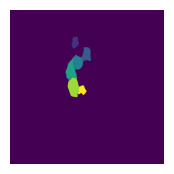

In [ ]:
# view 1 image
#img = io.imread(files[-1])
plt.figure(figsize=(2,2))
plt.imshow(data_dict['masks'])
plt.axis('off')
plt.show()

In [ ]:
# An individual image file from training data: https://osf.io/cpkd2 which is  1B6-002OutlinedJB.tif and we can use this URL to download it directly: https://osf.io/download/cpkd2
# https://osf.io/rab5y which is  1B6-002OutlinedJB_seg.npy

# This link might work to download the whole folder "Training images and segmentations" ; see https://osf.io/tuhwn/files
# https://files.osf.io/v1/resources/tuhwn/providers/osfstorage/652d523f8a28b1066effcc40/?zip=

#! wget -O tmp.zip "https://files.osf.io/v1/resources/tuhwn/providers/osfstorage/652d523f8a28b1066effcc40/?zip="

# The zip file size is 1.68 GB and it takes 19-20 minutes to download.
# Let's try to be kind to the OSF servers and not do that very often.

# Cellpose-written code starts here
with some additions by Ross

from https://nbviewer.org/github/MouseLand/cellpose/blob/master/notebooks/run_cellpose.ipynb which I found via https://cellpose.readthedocs.io/en/latest/notebook.html

Can we train in a notebook rather than in the GUI? See
https://cellpose.readthedocs.io/en/latest/train.html


Other possibly useful links:
* https://cellpose.readthedocs.io/en/latest/outputs.html
* https://forum.image.sc/t/i-want-to-get-individual-images-from-seg-npy-file-using-cellpose-2-2/78805/2
* https://cellpose.readthedocs.io/en/latest/train.html
* https://www.reddit.com/r/CodingHelp/comments/1ep0iis/how_to_count_cellpose_mask_size/
* https://forum.image.sc/t/cellpose-segmentation-in-jupyter-notebook/83841/7


In [ ]:
pip install cellpose

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 225.9/225.9 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 77.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 75.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 48.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 76.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 81.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45

In [ ]:
# load an example .npy file:
# /content/Model 1_train_losses.npy
import numpy as np

# Load the .npy file
#data = np.load('Model 1_train_losses.npy')

In [ ]:
#data

In [ ]:
# # plot the data using the matplotlib api interface:
# import matplotlib.pyplot as plt
# fig, ax=plt.subplots()
# ax.plot(data)

Downloading: "http://www.cellpose.org/static/images/img02.png" to img02.png
100%|██████████| 131k/131k [00:00<00:00, 2.68MB/s]
Downloading: "http://www.cellpose.org/static/images/img03.png" to img03.png
100%|██████████| 135k/135k [00:00<00:00, 2.64MB/s]
Downloading: "http://www.cellpose.org/static/images/img05.png" to img05.png
100%|██████████| 180k/180k [00:00<00:00, 2.65MB/s]


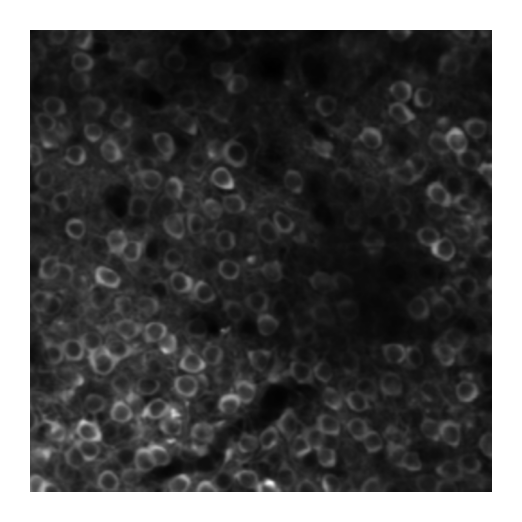

In [ ]:
import numpy as np
import time, os, sys
from urllib.parse import urlparse
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
mpl.rcParams['figure.dpi'] = 300
from cellpose import utils, io

# I will download images from website
urls = ['http://www.cellpose.org/static/images/img02.png',
        'http://www.cellpose.org/static/images/img03.png',
        'http://www.cellpose.org/static/images/img05.png']
files = []
for url in urls:
    parts = urlparse(url)
    filename = os.path.basename(parts.path)
    if not os.path.exists(filename):
        sys.stderr.write('Downloading: "{}" to {}\n'.format(url, filename))
        utils.download_url_to_file(url, filename)
    files.append(filename)

# REPLACE FILES WITH YOUR IMAGE PATHS
# files = ['img0.tif', 'img1.tif']

# view 1 image
img = io.imread(files[-1])
plt.figure(figsize=(2,2))
plt.imshow(img)
plt.axis('off')
plt.show()

In [ ]:
# RUN CELLPOSE

from cellpose import models, io

#print(cellpose.__version__)

# DEFINE CELLPOSE MODEL
# model_type='cyto' or model_type='nuclei'
model = models.Cellpose(gpu=False, model_type='cyto')

# define CHANNELS to run segementation on
# grayscale=0, R=1, G=2, B=3
# channels = [cytoplasm, nucleus]
# if NUCLEUS channel does not exist, set the second channel to 0
# channels = [0,0]
# IF ALL YOUR IMAGES ARE THE SAME TYPE, you can give a list with 2 elements
# channels = [0,0] # IF YOU HAVE GRAYSCALE
# channels = [2,3] # IF YOU HAVE G=cytoplasm and B=nucleus
# channels = [2,1] # IF YOU HAVE G=cytoplasm and R=nucleus

# or if you have different types of channels in each image
channels = [[2,3], [0,0], [0,0]]

# if diameter is set to None, the size of the cells is estimated on a per image basis
# you can set the average cell `diameter` in pixels yourself (recommended)
# diameter can be a list or a single number for all images

# you can run all in a list e.g.
# >>> imgs = [io.imread(filename) in for filename in files]
# >>> masks, flows, styles, diams = model.eval(imgs, diameter=None, channels=channels)
# >>> io.masks_flows_to_seg(imgs, masks, flows, diams, files, channels)
# >>> io.save_to_png(imgs, masks, flows, files)

# or in a loop
for chan, filename in zip(channels, files):
    # print the current date and time:
    print(time.strftime("%c"))
    print("processing:",filename)
    img = io.imread(filename)
    masks, flows, styles, diams = model.eval(img, diameter=None, channels=chan)

    # save results so you can load in gui
    # aross15 says: the provided code has this:
    #io.masks_flows_to_seg(img, masks, flows, diams, filename, chan)
    # but that gets the order of the arguments wrong, causing an error
    # where splitext(p) is passed a number (float) rather than a path string!
    # Instead we need to pay attention to its definition:
    #def masks_flows_to_seg(images, masks, flows, file_names, diams=30.0, channels=None, imgs_restore=None, restore_type=None, ratio=1.0)
    io.masks_flows_to_seg(img, masks, flows,  filename, diams, chan)


    # save results as png
    io.save_to_png(img, masks, flows, filename)

print("finished with for loop")
print(time.strftime("%c"))


100%|██████████| 25.3M/25.3M [00:00<00:00, 97.9MB/s]
100%|██████████| 5.23k/5.23k [00:00<00:00, 9.66MB/s]


Sun Feb 16 20:54:28 2025
processing: img02.png
Sun Feb 16 20:54:53 2025
processing: img03.png
Sun Feb 16 20:55:16 2025
processing: img05.png
finished with for loop
Sun Feb 16 20:56:06 2025


In [ ]:
io.masks_flows_to_seg

<function cellpose.io.masks_flows_to_seg(images, masks, flows, file_names, diams=30.0, channels=None, imgs_restore=None, restore_type=None, ratio=1.0)>

In [ ]:
# img, masks, flows, diams, filename, chan)
print("img.shape:",img.shape)
print("masks.shape:",masks.shape)
print("len(flows):",len(flows)) # can't do flows.shape since it's a list not a numpy array
print("diams",diams) # diams is just a float
print("filename:",filename)
print("chan:",chan)


img.shape: (677, 677, 3)
masks.shape: (677, 677)
len(flows): 3
diams 30.77808020788433
filename: img05.png
chan: [0, 0]


In [ ]:
#https://cellpose.readthedocs.io/en/latest/_modules/cellpose/models.html
# says
#
                #- masks (list, np.ndarray): labelled image(s), where 0=no masks; 1,2,...=mask labels
                #- flows (list): list of lists: flows[k][0] = XY flow in HSV 0-255; flows[k][1] = XY(Z) flows at each pixel; flows[k][2] = cell probability (if > cellprob_threshold, pixel used for dynamics); flows[k][3] = final pixel locations after Euler integration
                #- styles (list, np.ndarray): style vector summarizing each image of size 256.

# so that says flows[2] is the cellprobs

In [ ]:
masks

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   7,   0,   0],
       ...,
       [  0, 205, 205, ...,   0,   0,   0],
       [  0, 205, 205, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0]], dtype=uint16)

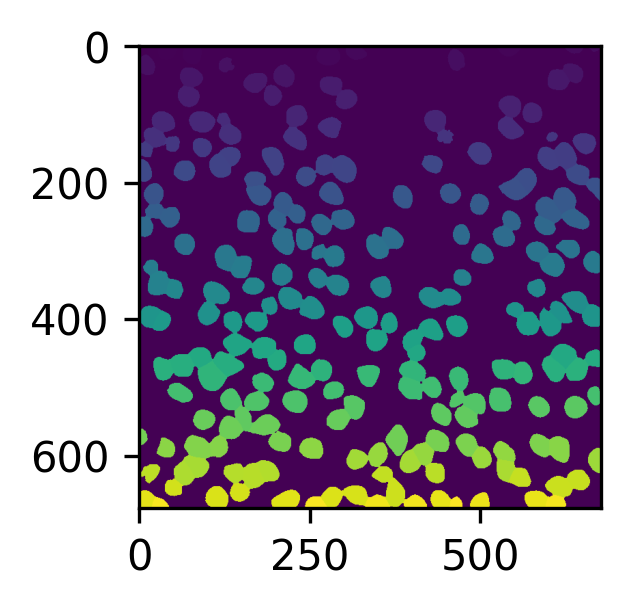

In [ ]:
plt.figure(figsize=(2,2))
plt.imshow(masks)

array([[[  0,   0,   0],
        [  0,   1,   1],
        [  0,   1,   1],
        ...,
        [  4,  28,  55],
        [  3,  18,  39],
        [  1,   5,  14]],

       [[  0,   0,   0],
        [  0,   1,   0],
        [  0,   1,   0],
        ...,
        [ 19,  36, 109],
        [ 19,  23,  84],
        [  9,   9,  36]],

       [[  0,   0,   0],
        [  0,   1,   0],
        [  1,   1,   0],
        ...,
        [ 33,  29, 125],
        [ 32,  19, 103],
        [ 18,   7,  50]],

       ...,

       [[ 68,  71,   0],
        [157, 131,   1],
        [195, 131,   6],
        ...,
        [ 30,   0,  27],
        [ 31,   0,  31],
        [  9,   0,  12]],

       [[ 57,  50,   0],
        [136,  97,   3],
        [180, 103,  10],
        ...,
        [ 29,   0,  21],
        [ 26,   0,  21],
        [  7,   0,   8]],

       [[ 23,  18,   0],
        [ 62,  36,   3],
        [ 88,  42,   8],
        ...,
        [ 12,   1,   5],
        [  9,   1,   4],
        [  5,   0,   3]]], dtype=uint8)
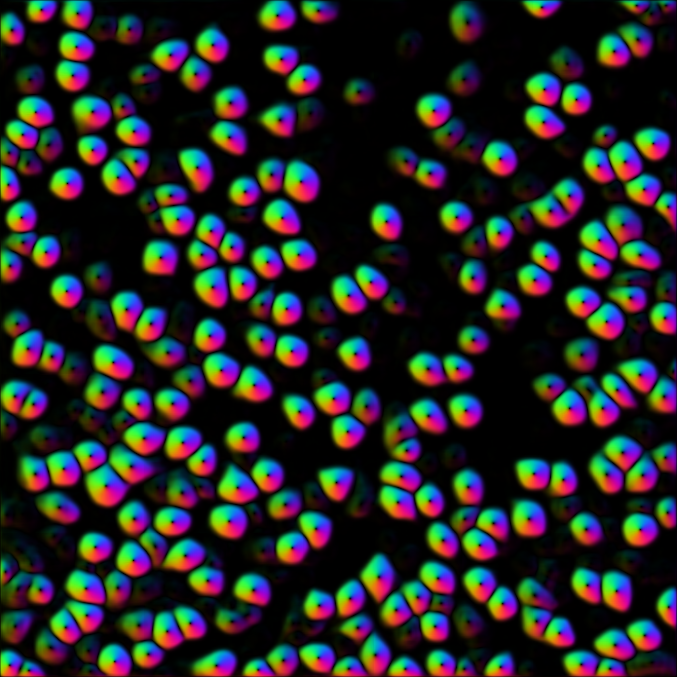

In [ ]:
flows[0]

In [ ]:
flows[1].shape

(2, 677, 677)

In [ ]:
flows[1][0,:,:]

array([[ 2.5119385e-02,  3.5683107e-02,  4.9380947e-02, ...,
         9.4077194e-01,  6.3091093e-01,  2.1526335e-01],
       [ 1.1538599e-02,  1.4840469e-02,  2.1410991e-02, ...,
         1.3654083e+00,  8.9202160e-01,  3.5465595e-01],
       [ 1.3511779e-03, -4.7703497e-03, -8.8900337e-03, ...,
         1.1292627e+00,  7.3757458e-01,  2.6974252e-01],
       ...,
       [-8.3247578e-01, -2.2919931e+00, -3.1931832e+00, ...,
        -4.3538955e-01, -3.9676854e-01, -8.8721432e-02],
       [-8.1547558e-01, -2.1800480e+00, -3.1285946e+00, ...,
        -4.5642322e-01, -3.8963389e-01, -9.3637168e-02],
       [-3.5818633e-01, -1.0717219e+00, -1.6057060e+00, ...,
        -2.2528538e-01, -1.8321227e-01, -1.0605230e-01]], dtype=float32)

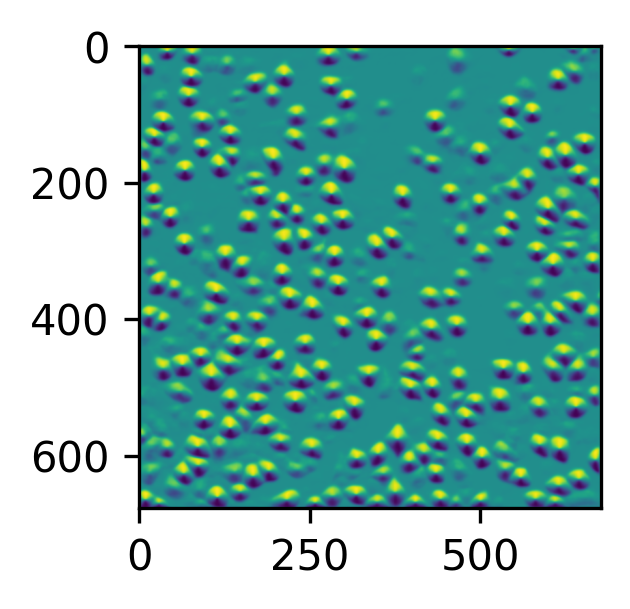

In [ ]:
plt.figure(figsize=(2,2))
plt.imshow(flows[1][0,:,:])
# This shows strong up-down orientation so it's probably the Y flows?

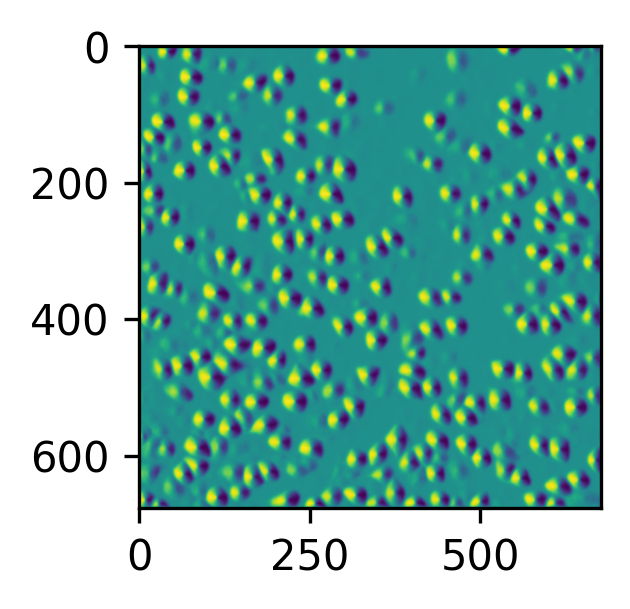

In [ ]:
plt.figure(figsize=(2,2))
plt.imshow(flows[1][1,:,:])
# This shows strong left-right orientation so it's probably the X flows?

In [ ]:
print(flows[2].shape)
print(np.min(flows[2]))
print(np.max(flows[2]))

(677, 677)
-17.221563
11.061508


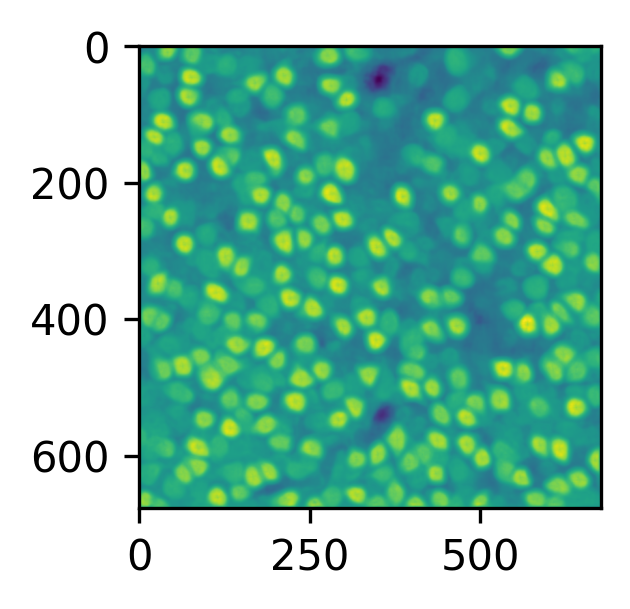

In [ ]:
plt.figure(figsize=(2,2))
plt.imshow(flows[2])
# probably the cellprobs

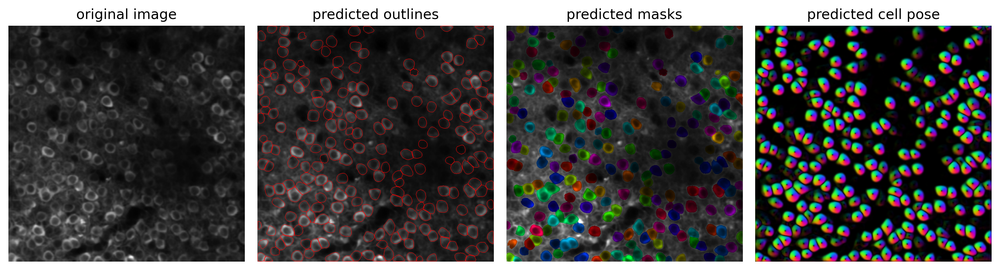

In [ ]:
# DISPLAY RESULTS
from cellpose import plot

fig = plt.figure(figsize=(12,5))
plot.show_segmentation(fig, img, masks, flows[0], channels=chan)
plt.tight_layout()
plt.show()

In [ ]:
# you can run all in a list e.g.
# >>> imgs = [io.imread(filename) in for filename in files]
# >>> masks, flows, styles, diams = model.eval(imgs, diameter=None, channels=channels)
# >>> io.masks_flows_to_seg(imgs, masks, flows, diams, files, channels)
# >>> io.save_to_png(imgs, masks, flows, files)

# you can run all in a list e.g.
print(time.strftime("%c"))
print("doing imread")
imgs = [io.imread(filename) for filename in files]
print(time.strftime("%c"))
print("doing model.eval;expect 2 minutes for 3 images")
masks, flows, styles, diams = model.eval(imgs, diameter=None, channels=channels)
print(time.strftime("%c"))
print("doing masks_flows_to_seg")
#io.masks_flows_to_seg(imgs, masks, flows, diams, files, channels) # wrong argument order
io.masks_flows_to_seg(img, masks, flows,  files, diams, channels)

print(time.strftime("%c"))
print("doing save_to_png")
io.save_to_png(imgs, masks, flows, files)
print(time.strftime("%c"))
print("done")


Sun Feb 16 20:59:54 2025
doing imread
Sun Feb 16 20:59:54 2025
doing model.eval;expect 2 minutes for 3 images
Sun Feb 16 21:01:29 2025
doing masks_flows_to_seg
Sun Feb 16 21:01:29 2025
doing save_to_png
Sun Feb 16 21:01:29 2025
done


img02.png


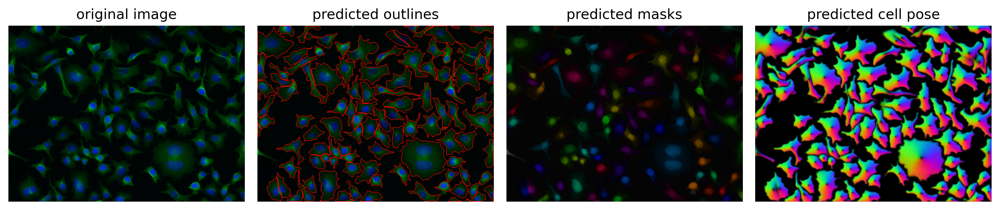

img03.png


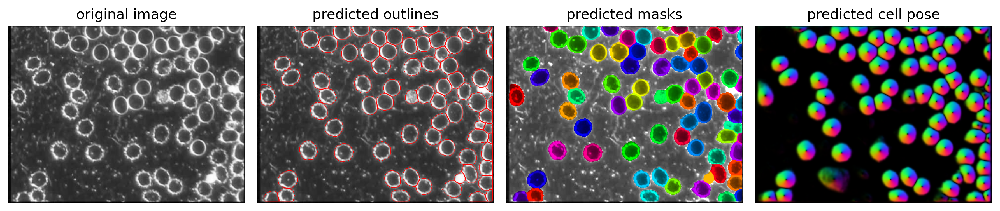

img05.png


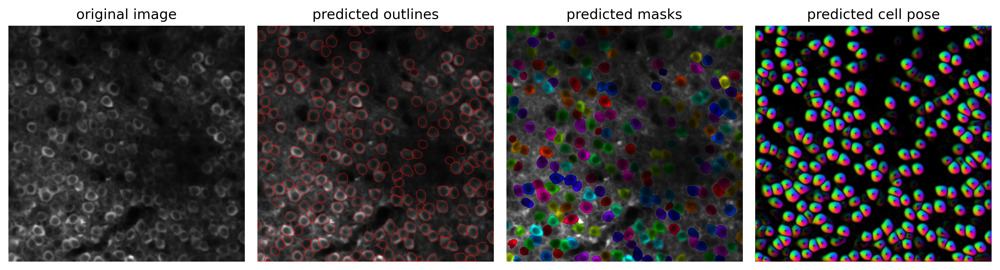

In [ ]:
for ii in range(len(files)):
    print(files[ii])
    fig = plt.figure(figsize=(12,5))
    plot.show_segmentation(fig, imgs[ii], masks[ii], flows[ii][0], channels=channels[ii])
    plt.tight_layout()
    plt.show()

## Also try the CPx model

See if it has a different object structure than the "cyto" model. I think CPx is newer than "cyto". In Summer 2023 we trained our new model starting from the CPx weights.


In [ ]:
model_cyto = models.Cellpose(gpu=False, model_type='cyto')


In [ ]:
vars(model_cyto)

{'device': device(type='cpu'),
 'gpu': False,
 'backbone': 'default',
 'diam_mean': 30.0,
 'nchan': 2,
 'cp': <cellpose.models.CellposeModel at 0x7b0896bc6110>,
 'pretrained_size': '/root/.cellpose/models/size_cytotorch_0.npy',
 'sz': <cellpose.models.SizeModel at 0x7b0896c6e2d0>}

In [ ]:
model_t_2_201 = models.CellposeModel(pretrained_model='Cellpose Autophagy Body model t_2_201')
# the "net" component of the object takes up a lot of space in the output when we do "vars(model)"
# so we're creating a temporary version that we'll remove the "net" component from, or at least set it to something small.
model_t_2_201_no_net = models.CellposeModel(pretrained_model='Cellpose Autophagy Body model t_2_201')
model_t_2_201_no_net.net = None

# model_t_2_201 = models.Cellpose(pretrained_model='Cellpose Autophagy Body model t_2_201') # doesn't work

In [ ]:
# model_CPx = models.Cellpose(gpu=False, model_type='CPx') # fails because
# "CPx doesn't have a pretrained size model, but you can still use CPx without the size model by creating a CellposeModel(model_type='CPx') object and calling .eval() on that."
# according to https://github.com/MouseLand/cellpose/issues/835
model_CPx = models.CellposeModel(gpu=False, model_type='CPx') #
# the "net" component of the object takes up a lot of space in the output when we do "vars(model)"
# so we're creating a temporary version that we'll remove the "net" component from, or at least set it to something small.
model_CPx_no_net = models.CellposeModel(gpu=False, model_type='CPx') #
model_CPx_no_net.net = None


100%|██████████| 25.3M/25.3M [00:00<00:00, 95.6MB/s]


In [ ]:
vars(model_t_2_201_no_net)

{'diam_mean': 30.0,
 'mkldnn': True,
 'device': device(type='cpu'),
 'gpu': False,
 'nchan': 2,
 'nclasses': 3,
 'nbase': [2, 32, 64, 128, 256],
 'pretrained_model': 'Cellpose Autophagy Body model t_2_201',
 'net': None,
 'diam_labels': 124.99279,
 'net_ortho': None,
 'net_type': 'cellpose_default'}

In [ ]:
vars(model_CPx_no_net)

{'diam_mean': 30.0,
 'mkldnn': True,
 'device': device(type='cpu'),
 'gpu': False,
 'nchan': 2,
 'nclasses': 3,
 'nbase': [2, 32, 64, 128, 256],
 'pretrained_model': '/root/.cellpose/models/CPx',
 'net': None,
 'diam_labels': 30.0,
 'net_ortho': None,
 'net_type': 'cellpose_default'}

In [ ]:
model_cyto_no_net = models.Cellpose(gpu=False, model_type='cyto')
model_cyto_no_net.cp.net = None
vars(model_cyto_no_net.cp)

{'diam_mean': 30.0,
 'mkldnn': True,
 'device': device(type='cpu'),
 'gpu': False,
 'nchan': 2,
 'nclasses': 3,
 'nbase': [2, 32, 64, 128, 256],
 'pretrained_model': '/root/.cellpose/models/cytotorch_0',
 'net': None,
 'diam_labels': 30.0,
 'net_ortho': None,
 'net_type': 'cellpose_default',
 'model_type': 'cyto'}

What I have learned:
"cyto" is something we get from models.CellPose not models.CellPoseModel. "cyto" has both a CellPoseModel (the cp component) and a SizeModel (the sz component).
CPx and our EMU-trained model don't have a a SizeModel to them so they aren't qualified to be called a models.CellPose object; instead they are like the cp component of cyto (I think).

# Trying to run it with our trained model and an image; similar to Bryan's work

In [ ]:
model = models.CellposeModel(pretrained_model='Cellpose Autophagy Body model t_2_201')

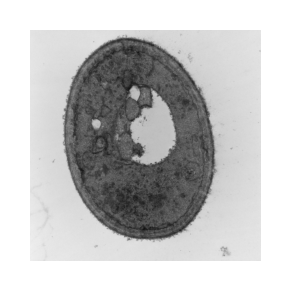

In [ ]:
# REPLACE FILES WITH YOUR IMAGE PATHS
# files = ['img0.tif', 'img1.tif']
files = [img_file]
files = [img_file, img_file] # same file twice, but we'll modify the image the 2nd time after we read it in


# view 1 image
img = io.imread(files[-1])
plt.figure(figsize=(1,1))
plt.imshow(img)
plt.axis('off')
plt.show()

In [ ]:
# define CHANNELS to run segementation on
# grayscale=0, R=1, G=2, B=3
# channels = [cytoplasm, nucleus]
# if NUCLEUS channel does not exist, set the second channel to 0
# channels = [0,0]
# IF ALL YOUR IMAGES ARE THE SAME TYPE, you can give a list with 2 elements
channels = [0,0] # IF YOU HAVE GRAYSCALE
channels = [ [0,0] , [0,0] ] # list of lists, one list for each file
channels = [ [0,0] ] * len(files) # repeats once for each file in the list of files

# channels = [2,3] # IF YOU HAVE G=cytoplasm and B=nucleus
# channels = [2,1] # IF YOU HAVE G=cytoplasm and R=nucleus

In [ ]:
ii=0
flowslist = []
for chan, filename in zip(channels, files):
    # print the current date and time:
    print(time.strftime("%c"))
    print("processing:",filename)
    print(f"chan: {chan}")
    img = io.imread(filename)

    # temporary code: playing with modifying the image to see how cellpose results change
    img = img * (1-0.10*ii) # some percent darker each iteration
    #img = img + np.sqrt(img) * (ii) # nonlinear brightening

    print(np.mean(img))
    #masks, flows, styles, diams = model.eval(img, diameter=None, channels=channels)
    # https://cellpose.readthedocs.io/en/latest/outputs.html
    # says to expect:
    # masks, flows, styles
    #results= model.eval(img, diameter=None, channels=chan)
    results= model.eval(img, diameter=129, channels=chan)
    # results = model.eval(img, diameter=129, channels=[0, 0]) # from Bryan's code
    if len(results) == 4:
      masks, flows, styles, diams= results
    else:
      masks, flows, styles = results  # Handle case where only 3 values are returned
    #masks, flows, styles, diams = model.eval(img, diameter=None)

    print(np.mean(flows[2] ))
    # save results so you can load in gui
    # aross15 says: the provided code has this:
    #io.masks_flows_to_seg(img, masks, flows, diams, filename, chan)
    # but that gets the order of the arguments wrong, causing an error
    # where splitext(p) is passed a number (float) rather than a path string!
    # Instead we need to pay attention to its definition:
    #def masks_flows_to_seg(images, masks, flows, file_names, diams=30.0, channels=None, imgs_restore=None, restore_type=None, ratio=1.0)
    io.masks_flows_to_seg(img, masks, flows,  filename, diams, chan)


    # save results as png
    io.save_to_png(img, masks, flows, f"{ii}_{filename}")

    flowslist.append(flows.copy())
    ii+=1

print("finished with for loop")
print(time.strftime("%c"))

Sun Feb 16 21:01:39 2025
processing: 1B6-058OutlinedJB.tif
chan: [0, 0]
161.31147281568877
-8.81037
Sun Feb 16 21:01:56 2025
processing: 1B6-058OutlinedJB.tif
chan: [0, 0]
145.18032553412002
-8.81037
finished with for loop
Sun Feb 16 21:02:11 2025


In [ ]:
def compute_summaries(orig_img, new_img, ignore_img=None):
  # doesn't care if the values in the orig & new arrays are 0-1, 0-255, -10 to 10, or whatever.
  # ignore_img should be binary: 1=ignore, 0=not ignore
  diff_img = new_img - orig_img
  if ignore_img is not None:
    # set the pixels of diff_img to NaN where ignore_img pixel is 1
    diff_img[ignore_img == 1] = np.NaN

  mean_diff = np.nanmean(diff_img)
  #mean_diff = np.mean(diff_img)
  std_diff = np.nanstd(diff_img)
  max_diff = np.max(diff_img)
  min_diff = np.min(diff_img)
  rmse_diff = np.sqrt(np.nanmean((diff_img)**2))
  pct_nonzero_diff = 100*np.nanmean(diff_img != 0) # how to handle nan?
  return mean_diff, std_diff, max_diff, min_diff, rmse_diff, pct_nonzero_diff

In [ ]:
mean_diff, std_diff, max_diff, min_diff, rmse_diff, pct_nonzero_diff = compute_summaries(flowslist[0][2], flowslist[1][2], ignore_img=None)

In [ ]:
print(mean_diff, std_diff, max_diff, min_diff, rmse_diff, pct_nonzero_diff)

2.7465585e-08 1.2087628e-06 5.722046e-06 -8.583069e-06 1.2090751e-06 65.30119977678571


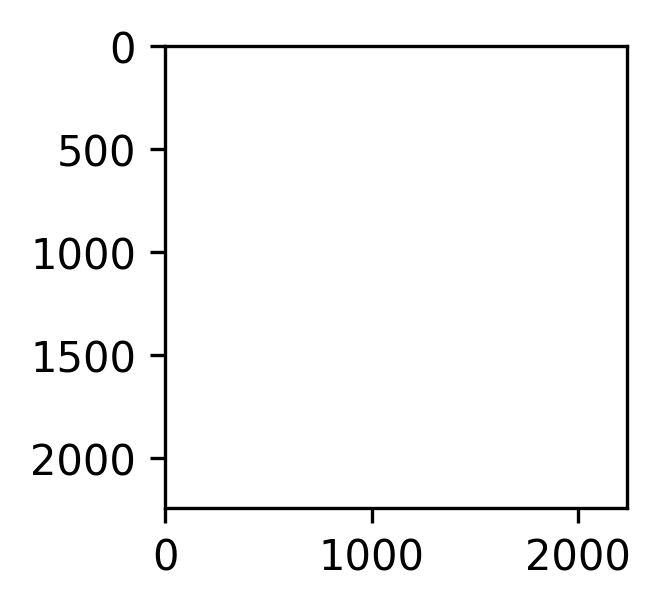

In [ ]:
plt.figure(figsize=(2,2))
plt.imshow(img)

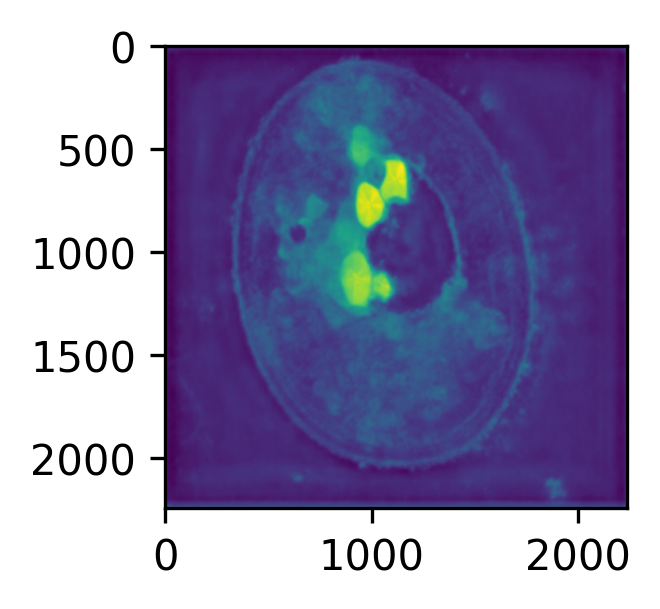

In [ ]:
orig_img, new_img = flowslist[0][2], flowslist[1][2]
new_img = new_img * 1.1
diff_img = new_img - orig_img
plt.figure(figsize=(2,2))
plt.imshow(diff_img)


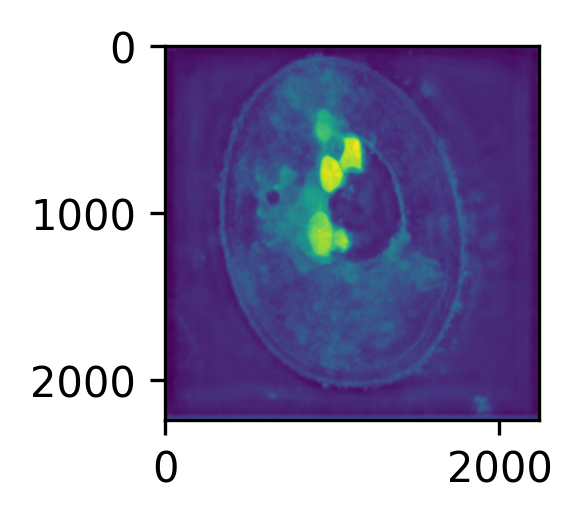

array([[-8.742563 , -8.742563 , -8.747545 , ..., -8.177238 , -8.167956 ,
        -8.167956 ],
       [-8.742563 , -8.742563 , -8.747545 , ..., -8.177238 , -8.167956 ,
        -8.167956 ],
       [-8.673754 , -8.673754 , -8.68278  , ..., -8.144903 , -8.134578 ,
        -8.134578 ],
       ...,
       [-6.416876 , -6.416876 , -6.399296 , ..., -7.313006 , -7.342373 ,
        -7.342373 ],
       [-6.438058 , -6.438058 , -6.4154887, ..., -7.317184 , -7.349454 ,
        -7.349454 ],
       [-6.438058 , -6.438058 , -6.4154887, ..., -7.317184 , -7.349454 ,
        -7.349454 ]], dtype=float32)

In [ ]:
# let's try plotting the results...
plt.figure(figsize=(2,2))
plt.imshow(flows[2])
plt.tight_layout()
plt.show()
flows[2]

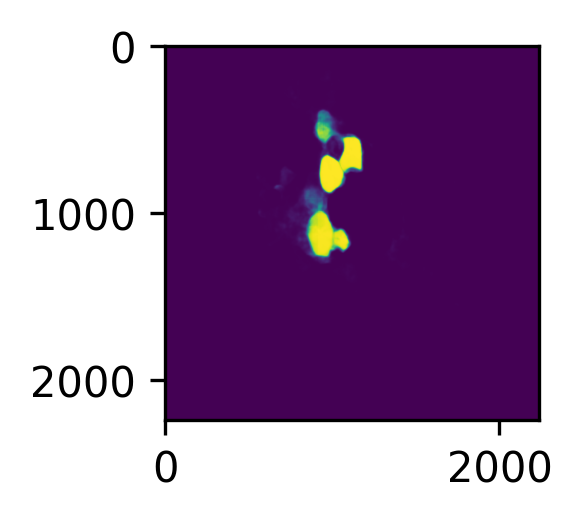

array([[-8.742563 , -8.742563 , -8.747545 , ..., -8.177238 , -8.167956 ,
        -8.167956 ],
       [-8.742563 , -8.742563 , -8.747545 , ..., -8.177238 , -8.167956 ,
        -8.167956 ],
       [-8.673754 , -8.673754 , -8.68278  , ..., -8.144903 , -8.134578 ,
        -8.134578 ],
       ...,
       [-6.416876 , -6.416876 , -6.399296 , ..., -7.313006 , -7.342373 ,
        -7.342373 ],
       [-6.438058 , -6.438058 , -6.4154887, ..., -7.317184 , -7.349454 ,
        -7.349454 ],
       [-6.438058 , -6.438058 , -6.4154887, ..., -7.317184 , -7.349454 ,
        -7.349454 ]], dtype=float32)

In [ ]:
# the values there are "used as inputs to a sigmoid centered at zero (1 / (1 + e^-x)) in the loss function (binary cross-entropy loss), so they vary from around -10 to +10. "
# https://cellpose.readthedocs.io/en/latest/outputs.html
# so let's try putting them through the sigmoid (also called logistic) to get values between 0 and 1
plt.figure(figsize=(2,2))
plt.imshow(1/(1+np.exp(-flows[2])))
plt.tight_layout()
plt.show()
flows[2]

# Kwabena's section

Next, Kwabena will put code here to try splitting the input image left-right, changing it to right-left, then re-run cellpose on it. Then show the masks output.

In [ ]:
model = models.CellposeModel(pretrained_model='Cellpose Autophagy Body model t_2_201')

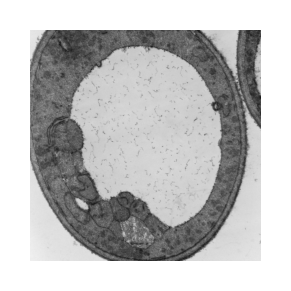

In [ ]:
# REPLACE FILES WITH YOUR IMAGE PATHS
# files = ['img0.tif', 'img1.tif']
files = [img_file]
files = df_files['filename']
tif_files = [f for f in files if f.endswith('.tif')]
files = tif_files
# Gemini also suggests: tif_files = df_files[df_files['filename'].str.endswith('.tif')]['filename']

# view 1 image
img = io.imread(files[-1])
plt.figure(figsize=(1,1))
plt.imshow(img)
plt.axis('off')
plt.show()

In [ ]:
# define CHANNELS to run segementation on
# grayscale=0, R=1, G=2, B=3
# channels = [cytoplasm, nucleus]
# if NUCLEUS channel does not exist, set the second channel to 0
# channels = [0,0]
# IF ALL YOUR IMAGES ARE THE SAME TYPE, you can give a list with 2 elements
channels = [0,0] # IF YOU HAVE GRAYSCALE
channels = [ [0,0] , [0,0] ] # list of lists, one list for each file
channels = [ [0,0] ] * len(files) # repeats once for each file in the list of files

# channels = [2,3] # IF YOU HAVE G=cytoplasm and B=nucleus
# channels = [2,1] # IF YOU HAVE G=cytoplasm and R=nucleus

In [ ]:
def run_cellpose(model,img,diameter=129,chan=[0,0],filename=None):
  # shouldn't depend on the defaults, but I wanted to give them as examples.
  # print the current date and time:
    print(time.strftime("%c"))
    print("processing:",filename)
    #print(f"chan: {chan}")
    #masks, flows, styles, diams = model.eval(img, diameter=None, channels=channels)
    # https://cellpose.readthedocs.io/en/latest/outputs.html
    # says to expect:
    # masks, flows, styles
    #results= model.eval(img, diameter=None, channels=chan)
    results= model.eval(img, diameter=diameter, channels=chan)
    results = list(results) # handy to have it be a list, not a tuple, later.
    # results = model.eval(img, diameter=129, channels=[0, 0]) # from Bryan's code
    if len(results) == 4:
      masks, flows, styles, diams= results
      io.masks_flows_to_seg(img, masks, flows,  filename, diams, chan)

    else:
      masks, flows, styles = results  # Handle case where only 3 values are returned
      results.append(None) # make a 4th entry where "diams" would have been.
      # And, try calling masks_flows_to_seg without the diams argument:
      io.masks_flows_to_seg(img, masks, flows,  filename,  channels=chan)
    #masks, flows, styles, diams = model.eval(img, diameter=None)

    #print(np.mean(flows[2] ))

    # save results so you can load in gui
    # aross15 says: the provided code has this:
    #io.masks_flows_to_seg(img, masks, flows, diams, filename, chan)
    # but that gets the order of the arguments wrong, causing an error
    # where splitext(p) is passed a number (float) rather than a path string!
    # Instead we need to pay attention to its definition:
    #def masks_flows_to_seg(images, masks, flows, file_names, diams=30.0, channels=None, imgs_restore=None, restore_type=None, ratio=1.0)
    # Now this is done in the "if len(results)==4" if/else above.
    #io.masks_flows_to_seg(img, masks, flows,  filename, diams, chan)


    # save results as png
    io.save_to_png(img, masks, flows, filename)
    return results


In [ ]:
# importing cv2
import cv2

In [ ]:
ii=0
my_diam = 129
#flowslist = []
fname_list = []
imgs= []
chan_list = []
results_list = []
for chan, filename in zip(channels, files):
    print(f"main file: {filename} -----------------")
    img = io.imread(filename)
    imgs.append(img)
    chan_list.append(chan)
    # first, run cellpose on the original file:
    results_orig = run_cellpose(model,img,diameter=my_diam,chan=[0,0],filename=filename)
    fname_list.append(filename)
    results_list.append(results_orig)

    h, w = img.shape[0], img.shape[1]
    quarters = [          # in matlab notation, [0 1;2 3]
      img[:h//2, :w//2],  # Top-left
      img[:h//2, w//2:],  # Top-right
      img[h//2:, :w//2],  # Bottom-left
      img[h//2:, w//2:]   # Bottom-right
    ]
    # Swap left and right halves
    img_swap_LR = np.concatenate([
      np.concatenate([quarters[1], quarters[0]], axis=1),  # Top row swapped
      np.concatenate([quarters[3], quarters[2]], axis=1)   # Bottom row swapped
    ], axis=0)
    LR_fname = f"LR_{filename}"
    cv2.imwrite(LR_fname, img_swap_LR)
    imgs.append(img_swap_LR)
    chan_list.append(chan)
    results_LR = run_cellpose(model,img_swap_LR,diameter=my_diam,chan=[0,0],filename=LR_fname)
    # could remove the LR file here to save space if we want
    fname_list.append(LR_fname)
    results_list.append(results_LR)

    # Swap top and bottom (up/down) halves
    img_swap_UD = np.concatenate([
      np.concatenate([quarters[2], quarters[3]], axis=1),  # left half swapped
      np.concatenate([quarters[0], quarters[1]], axis=1)   # right half swapped
    ], axis=0)
    UD_fname = f"UD_{filename}"
    cv2.imwrite(UD_fname, img_swap_UD)
    imgs.append(img_swap_UD)
    chan_list.append(chan)
    results_UD = run_cellpose(model,img_swap_UD,diameter=my_diam,chan=[0,0],filename=UD_fname)
    # could remove the UD file here to save space if we want
    fname_list.append(UD_fname)
    results_list.append(results_UD)

    # Swap all quarters:
    img_swap_Q = np.concatenate([
      np.concatenate([quarters[3], quarters[2]], axis=1),  # new top row
      np.concatenate([quarters[1], quarters[0]], axis=1)   # new bottom row
    ], axis=0)
    Q_fname = f"Q_{filename}"
    cv2.imwrite(Q_fname, img_swap_Q)
    imgs.append(img_swap_Q)
    chan_list.append(chan)
    results_Q = run_cellpose(model,img_swap_Q,diameter=my_diam,chan=[0,0],filename=Q_fname)
    # could remove the Q file here to save space if we want
    fname_list.append(Q_fname)
    results_list.append(results_Q)

    #flowslist.append(flows.copy())
    ii+=1

print("finished with for loop")
print(time.strftime("%c"))

main file: 1B6-058OutlinedJB.tif -----------------
Sun Feb 16 22:04:32 2025
processing: 1B6-058OutlinedJB.tif
Sun Feb 16 22:04:46 2025
processing: LR_1B6-058OutlinedJB.tif
Sun Feb 16 22:04:58 2025
processing: UD_1B6-058OutlinedJB.tif
Sun Feb 16 22:05:10 2025
processing: Q_1B6-058OutlinedJB.tif
main file: 1B6-059OutlinedJB.tif -----------------
Sun Feb 16 22:05:20 2025
processing: 1B6-059OutlinedJB.tif
Sun Feb 16 22:05:50 2025
processing: LR_1B6-059OutlinedJB.tif
Sun Feb 16 22:06:19 2025
processing: UD_1B6-059OutlinedJB.tif
Sun Feb 16 22:06:49 2025
processing: Q_1B6-059OutlinedJB.tif
finished with for loop
Sun Feb 16 22:07:16 2025


In [ ]:
#for ii, fname in enumerate(fname_list):
    #print(ii, fname)
    # recall that the things in a results object are: masks, flows, styles, diams
    # so masks is element 0 and flows is element 1
    #flows = results_list[ii][1]
    # flows[2] is the cellprobs
    # plot flows[2]:

0 1B6-058OutlinedJB.tif


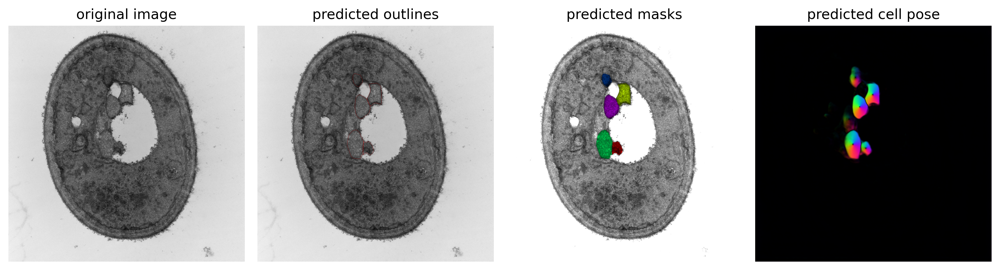

1 LR_1B6-058OutlinedJB.tif


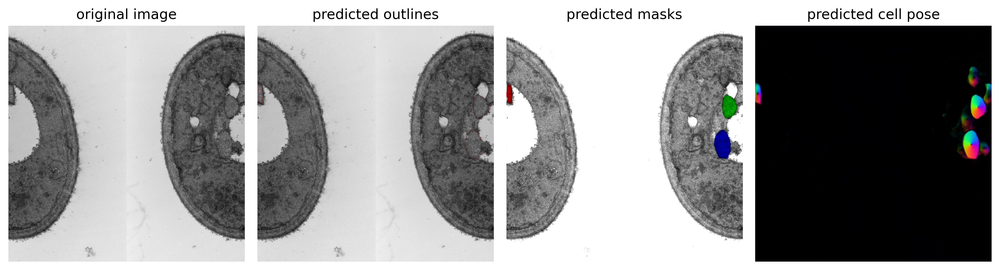

2 UD_1B6-058OutlinedJB.tif


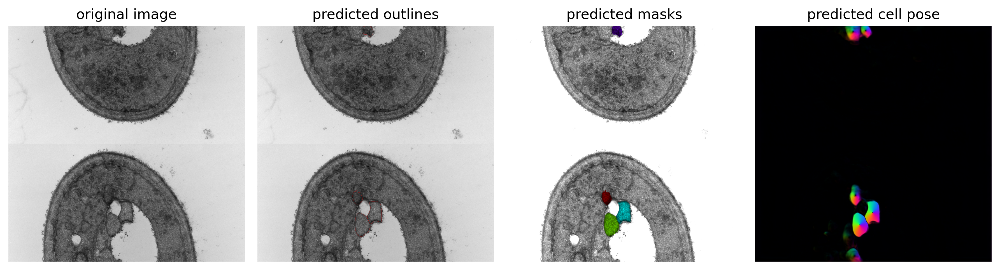

3 Q_1B6-058OutlinedJB.tif


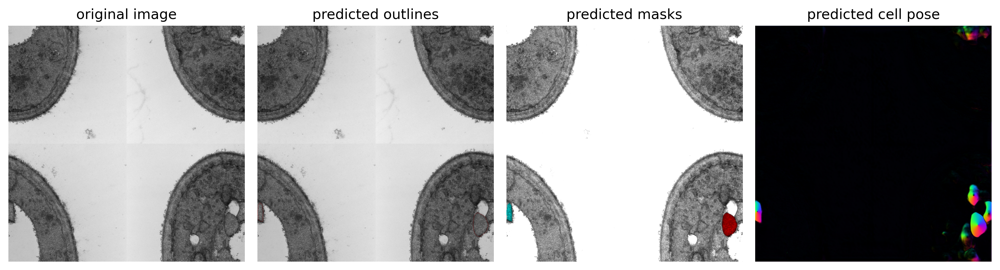

4 1B6-059OutlinedJB.tif


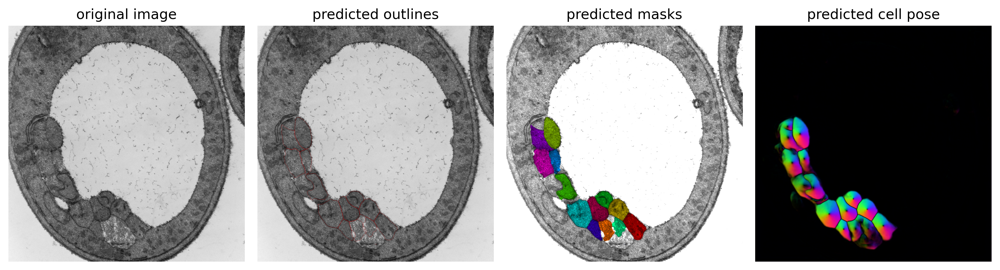

5 LR_1B6-059OutlinedJB.tif


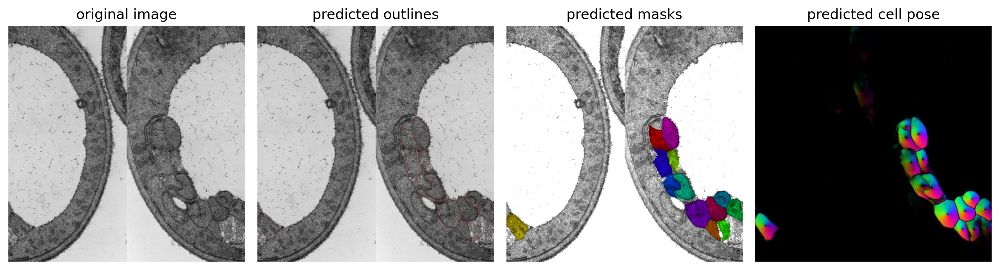

6 UD_1B6-059OutlinedJB.tif


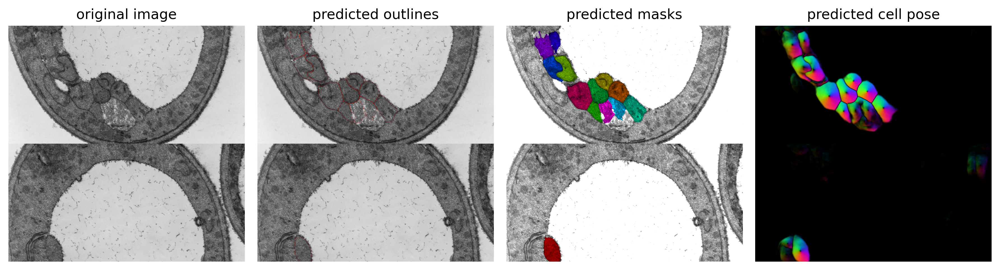

7 Q_1B6-059OutlinedJB.tif


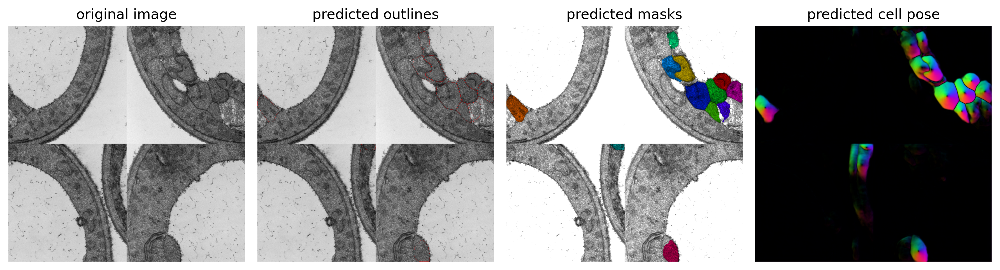

In [ ]:
for ii, fname in enumerate(fname_list):
    print(ii,fname)
    fig = plt.figure(figsize=(12,5))
    #plot.show_segmentation(fig, imgs[ii], masks[ii], flows[ii][0], channels=channels[ii])
    plot.show_segmentation(fig, imgs[ii], results_list[ii][0], results_list[ii][1][0], channels=chan_list[ii])
    plt.tight_layout()
    plt.show()

# Exploring the model: Stephanie's section


Visualizing the weights (somewhat):
https://www.youtube.com/shorts/hunbj9zKh3w

and then for later:
Visualizing what happens to an image on the way through a u-net:
https://www.youtube.com/watch?v=uJ63xbVPMKs

Maybe do some googling to see if someone has already posted code that can do this for us. Maybe start here: https://ravivaishnav20.medium.com/visualizing-feature-maps-using-pytorch-12a48cd1e573 and see https://discuss.pytorch.org/t/accessing-feature-maps-the-proper-way/178187/4 if needed

There's https://github.com/utkuozbulak/pytorch-cnn-visualizations but that's probably more for Bryan's approach to the project.


Reminder: if the weights of a convolution are all positive, that's like taking an average. If weights on the left are positive and weights on the right are negative, or vice versa, or up/down instead of left/right, that's like taking a derivative and is related to edge detection.

Sobel edge detection: https://youtu.be/uihBwtPIBxM?list=PLzH6n4zXuckoRdljSlM2k35BufTYXNNeF


In [ ]:
vars(model)

{'diam_mean': 30.0,
 'mkldnn': True,
 'device': device(type='cpu'),
 'gpu': False,
 'nchan': 2,
 'nclasses': 3,
 'nbase': [2, 32, 64, 128, 256],
 'pretrained_model': 'Cellpose Autophagy Body model t_2_201',
 'net': CPnet(
   (downsample): downsample(
     (down): Sequential(
       (res_down_0): resdown(
         (conv): Sequential(
           (conv_0): Sequential(
             (0): MkldnnBatchNorm()
             (1): ReLU(inplace=True)
             (2): MkldnnConv2d()
           )
           (conv_1): Sequential(
             (0): MkldnnBatchNorm()
             (1): ReLU(inplace=True)
             (2): MkldnnConv2d()
           )
           (conv_2): Sequential(
             (0): MkldnnBatchNorm()
             (1): ReLU(inplace=True)
             (2): MkldnnConv2d()
           )
           (conv_3): Sequential(
             (0): MkldnnBatchNorm()
             (1): ReLU(inplace=True)
             (2): MkldnnConv2d()
           )
         )
         (proj): Sequential(
           (0): M

In [ ]:
type(model)

cellpose.models.CellposeModel

In [ ]:
model.gpu # doing model['gpu'] doesn't work.

False

In [ ]:
#type(model.cp) # has type cellpose.models.CellposeModel

In [ ]:
type(model.cp.net) # has type cellpose.resnet_torch.CPnet

AttributeError: 'CellposeModel' object has no attribute 'cp'

In [ ]:
pip install torchinfo

In [ ]:
import torchinfo
torchinfo.summary(model.cp.net) # gives a result that's much too simple to be true.

In [ ]:
model.cp.net # shows a bunch of downsample, Sequential, resdown, MkldnnBatchNorm, MeLU, MkldnnConv2d layers but not the weights

In [ ]:
# trying to accessing the actual weights, not working yet.
#model.cp.net.downsample.down.res_down_0.conv.conv_0[2]
vars(model.cp.net)

In [ ]:
# I asked gemini how to access the weights in it and it gave this,
# which turns out to not work well since only two things are named_parameters?
import torch

# Assuming 'model' is your Cellpose model instance
for name, param in model.cp.net.named_parameters():
    print(name, type(param), param.shape)
    if 'weight' in name:
        print(f"Layer: {name}, Weight shape: {param.shape}")
        # Access the weight values using param.data
        # Example: print(param.data)

In [ ]:
import torch

for module in model.cp.net.modules():
    #print(module)
    print(type(module))
    if type(module) == torch.utils.mkldnn.MkldnnConv2d:
        print(module.named_parameters)

In [ ]:
# import torch

# for module in model.cp.net.modules():
#     print(type(module))
#     print(module.named_parameters)
#     # check if the module has parameters (e.g., weights and biases)
#     if any(p.requires_grad for p in module.parameters()):
#         for name, param in module.named_parameters():
#             if 'weight' in name:
#                 print(f"Module: {module.__class__.__name__}") # Print the module type
#                 print(f"Layer: {name}, Weight shape: {param.shape}")
#                 # Print the weight values
#                 #print(param.data)  # Uncomment if you want to see the actual values

In [ ]:
module.weight.shape

In [ ]:
# That's of type torch; we might want to turn it into a numpy ndarray.
# AI suggested: module.weight.detach().numpy()

In [ ]:
module.bias

In [ ]:

module.weight

# Loading our pretrained Cellpose model

In [ ]:
models.CellposeModel(pretrained_model='Cellpose Autophagy Body model t_2_201')